# Implement


In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
import os
from os.path import exists, join, basename, splitext

################# Need to revert back to CUDA 10.0 ##################
# Thanks to http://aconcaguasci.blogspot.com/2019/12/setting-up-cuda-100-for-mxnet-on-google.html
#Uninstall the current CUDA version
!apt-get --purge remove cuda nvidia* libnvidia-*
!dpkg -l | grep cuda- | awk '{print $2}' | xargs -n1 dpkg --purge
!apt-get remove cuda-*
!apt autoremove
!apt-get update

#Download CUDA 10.0
# !wget  --no-clobber https://developer.download.nvidia.com/compute/cuda/repos/ubuntu1804/x86_64/cuda-repo-ubuntu1804_10.0.130-1_amd64.deb
#install CUDA kit dpkg
!dpkg -i cuda-repo-ubuntu1804_10.0.130-1_amd64.deb
!sudo apt-key adv --fetch-keys https://developer.download.nvidia.com/compute/cuda/repos/ubuntu1804/x86_64/7fa2af80.pub
!apt-get update
!apt-get install cuda-10-0
#Slove libcurand.so.10 error
# !wget --no-clobber http://developer.download.nvidia.com/compute/machine-learning/repos/ubuntu1804/x86_64/nvidia-machine-learning-repo-ubuntu1804_1.0.0-1_amd64.deb
#-nc, --no-clobber: skip downloads that would download to existing files.
!apt install ./nvidia-machine-learning-repo-ubuntu1804_1.0.0-1_amd64.deb
!apt-get update
####################################################################

# git_repo_url = 'https://github.com/TadasBaltrusaitis/OpenFace.git'
# project_name = splitext(basename(git_repo_url))[0]
# clone openface
# !git clone -q --depth 1 $git_repo_url

# install new CMake becaue of CUDA10
# !wget -q https://cmake.org/files/v3.13/cmake-3.13.0-Linux-x86_64.tar.gz
!tar xfz cmake-3.13.0-Linux-x86_64.tar.gz --strip-components=1 -C /usr/local

# Get newest GCC
!sudo apt-get update
!sudo apt-get install build-essential 
!sudo apt-get install g++-8

# install python dependencies
!pip install -q youtube-dl

# Finally, actually install OpenFace
# !cd OpenFace && bash ./download_models.sh && sudo bash ./install.sh
!cd OpenFace && sudo bash ./install.sh

# Detect facial expressions on a test video

We are going to detect facial features on the following Youtube video:

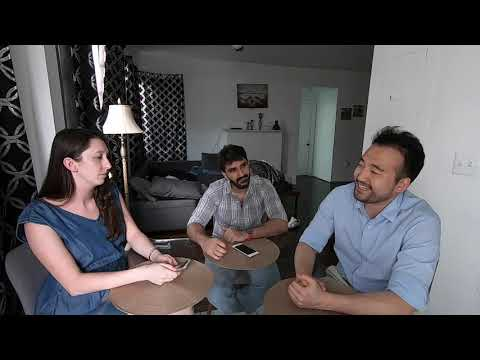

In [ ]:
from IPython.display import YouTubeVideo

# Change the Youtube_ID with the link to your group's video.
YOUTUBE_ID = 'XtA6FQz8BHQ'

YouTubeVideo(YOUTUBE_ID)

Download the above youtube video, cut the first 10 seconds and do the face detection & feature extraction on that clip. This takes about a minute or two. Instead of `FaceLandmarkVidMulti` you may also use `FeatureExtraction` to extract features of a single face or `FaceLandmarkImg` to extract features on a face image. See full description of the arguments [here](https://github.com/TadasBaltrusaitis/OpenFace/wiki/Command-line-arguments). 

In [ ]:
!rm -rf youtube.mp4
# download the youtube with the given ID
!youtube-dl -f 'bestvideo[ext=mp4]' --output "youtube.%(ext)s" https://www.youtube.com/watch?v=$YOUTUBE_ID
# cut the first 5 seconds
!ffmpeg -y -loglevel info -i youtube.mp4 -t 10 video.mp4
# clear any previous outputs.
!rm -rf processed
# detect poses on the these 10 seconds.
!./OpenFace/build/bin/FaceLandmarkVidMulti -f video.mp4 -out_dir processed
# convert the result into MP4
!ffmpeg -y -loglevel info -i processed/video.avi output.mp4

[youtube] XtA6FQz8BHQ: Downloading webpage
[youtube] XtA6FQz8BHQ: Downloading MPD manifest
[download] Destination: youtube.mp4
[download] 100% of 21.00MiB in 00:00
ffmpeg version 3.4.8-0ubuntu0.2 Copyright (c) 2000-2020 the FFmpeg developers
  built with gcc 7 (Ubuntu 7.5.0-3ubuntu1~18.04)
  configuration: --prefix=/usr --extra-version=0ubuntu0.2 --toolchain=hardened --libdir=/usr/lib/x86_64-linux-gnu --incdir=/usr/include/x86_64-linux-gnu --enable-gpl --disable-stripping --enable-avresample --enable-avisynth --enable-gnutls --enable-ladspa --enable-libass --enable-libbluray --enable-libbs2b --enable-libcaca --enable-libcdio --enable-libflite --enable-libfontconfig --enable-libfreetype --enable-libfribidi --enable-libgme --enable-libgsm --enable-libmp3lame --enable-libmysofa --enable-libopenjpeg --enable-libopenmpt --enable-libopus --enable-libpulse --enable-librubberband --enable-librsvg --enable-libshine --enable-libsnappy --enable-libsoxr --enable-libspeex --enable-libssh --enable-l

Finally, visualize the result:

In [ ]:
def show_local_mp4_video(file_name, width=640, height=480):
  import io
  import base64
  from IPython.display import HTML
  video_encoded = base64.b64encode(io.open(file_name, 'rb').read())
  return HTML(data='''<video width="{0}" height="{1}" alt="test" controls>
                        <source src="data:video/mp4;base64,{2}" type="video/mp4" />
                      </video>'''.format(width, height, video_encoded.decode('ascii')))

show_local_mp4_video('output.mp4', width=960, height=720)

# Extra: Here are some tips for loading and plotting the data. 

In [ ]:
%matplotlib inline
%config InlineBackend.figure_format = 'retina'
import pandas as pd, seaborn as sns
sns.set_style('white')
import matplotlib.pyplot as plt 

# Load data
df = pd.read_csv('processed/video.csv')
# Remove empty spaces in column names.
df.columns = [col.replace(" ", "") for col in df.columns]
# Print few values of data.
print(f"Max number of frames {df.frame.max()}", f"\nTotal shape of dataframe {df.shape}")
df.head()

Max number of frames 300 
Total shape of dataframe (947, 714)


,frame,face_id,timestamp,confidence,success,gaze_0_x,gaze_0_y,gaze_0_z,gaze_1_x,gaze_1_y,gaze_1_z,gaze_angle_x,gaze_angle_y,eye_lmk_x_0,eye_lmk_x_1,eye_lmk_x_2,eye_lmk_x_3,eye_lmk_x_4,eye_lmk_x_5,eye_lmk_x_6,eye_lmk_x_7,eye_lmk_x_8,eye_lmk_x_9,eye_lmk_x_10,eye_lmk_x_11,eye_lmk_x_12,eye_lmk_x_13,eye_lmk_x_14,eye_lmk_x_15,eye_lmk_x_16,eye_lmk_x_17,eye_lmk_x_18,eye_lmk_x_19,eye_lmk_x_20,eye_lmk_x_21,eye_lmk_x_22,eye_lmk_x_23,eye_lmk_x_24,eye_lmk_x_25,eye_lmk_x_26,...,p_29,p_30,p_31,p_32,p_33,AU01_r,AU02_r,AU04_r,AU05_r,AU06_r,AU07_r,AU09_r,AU10_r,AU12_r,AU14_r,AU15_r,AU17_r,AU20_r,AU23_r,AU25_r,AU26_r,AU45_r,AU01_c,AU02_c,AU04_c,AU05_c,AU06_c,AU07_c,AU09_c,AU10_c,AU12_c,AU14_c,AU15_c,AU17_c,AU20_c,AU23_c,AU25_c,AU26_c,AU28_c,AU45_c
0,1,0,0.000,0.98,1,-0.377982,0.451237,-0.808403,-0.595300,0.411779,-0.689968,-0.576,0.523,1427.8,1430.5,1435.6,1440.3,1441.8,1439.4,1434.0,1429.3,1420.4,1424.0,1428.5,1433.7,1438.7,1442.6,1445.2,1442.1,1437.9,1432.8,1428.0,1423.7,1432.2,1434.3,1436.6,1437.7,1437.1,1435.0,1432.7,...,0.605,0.300,0.111,0.122,0.043,0.37,0.0,0.0,0.00,0.31,0.00,0.0,0.47,0.00,0.00,0.00,1.06,0.91,0.00,0.00,0.00,2.56,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,1.0,0.0,0.0,0.0,0.0,1.0
1,1,1,0.000,0.88,1,0.170617,0.226819,-0.958876,0.022906,0.237220,-0.971186,0.100,0.236,932.6,933.8,937.2,940.8,942.6,941.7,938.0,934.4,928.1,930.1,933.1,936.8,940.7,943.9,946.2,943.9,940.7,937.1,933.6,930.5,936.2,937.8,939.3,939.8,939.1,937.5,936.0,...,0.002,0.018,-0.022,0.004,-0.005,0.00,0.0,0.0,0.75,0.00,0.00,0.0,0.58,0.05,2.04,0.36,1.60,1.34,0.03,0.67,2.03,1.08,0.0,1.0,0.0,0.0,0.0,1.0,1.0,1.0,0.0,1.0,1.0,1.0,1.0,0.0,1.0,0.0,1.0,1.0
2,1,2,0.000,0.03,0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000,0.000,365.8,368.4,373.4,378.1,379.5,377.4,371.9,367.3,361.0,364.0,368.1,373.1,378.3,382.2,384.9,381.2,376.5,371.7,367.2,363.5,370.4,372.5,374.9,376.1,375.4,373.2,370.9,...,-0.091,-0.132,-0.326,-0.143,0.166,1.85,0.0,0.0,0.00,0.64,0.00,0.0,1.61,0.53,0.73,0.54,0.06,1.36,1.37,0.00,0.92,0.31,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,1.0,0.0,1.0,1.0,0.0,0.0,1.0,0.0
3,2,0,0.033,0.98,1,-0.375557,0.464381,-0.802065,-0.590863,0.419239,-0.689289,-0.575,0.535,1429.7,1432.3,1437.5,1442.0,1443.3,1440.9,1435.6,1431.0,1421.9,1425.6,1430.2,1435.5,1440.4,1444.1,1446.5,1443.5,1439.3,1434.4,1429.5,1425.2,1433.9,1435.9,1438.2,1439.3,1438.8,1436.7,1434.5,...,0.523,0.326,0.156,0.171,0.032,0.72,0.0,0.0,0.00,0.40,0.00,0.0,0.44,0.00,0.00,0.00,0.90,1.02,0.04,0.00,0.00,2.48,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,1.0,0.0,0.0,0.0,0.0,1.0
4,2,1,0.033,0.88,1,0.182224,0.286096,-0.940714,0.028456,0.300343,-0.953407,0.111,0.300,932.7,933.7,937.0,940.6,942.4,941.6,938.1,934.5,928.1,930.2,933.1,936.8,940.5,943.6,945.9,943.7,940.6,937.1,933.6,930.5,936.2,937.8,939.2,939.7,938.9,937.3,935.9,...,0.023,0.084,-0.034,-0.056,-0.012,0.00,0.0,0.0,0.55,0.00,0.56,0.0,0.56,0.00,2.21,0.76,1.39,2.18,0.00,0.95,1.74,1.25,0.0,1.0,0.0,0.0,0.0,1.0,1.0,1.0,0.0,1.0,1.0,1.0,1.0,0.0,1.0,0.0,0.0,1.0


In [ ]:
# See how many unique faces there are
print("Number of unique faces: ", len(df.face_id.unique()), "\nList of face_id's: ", df.face_id.unique())

Number of unique faces:  4 
List of face_id's:  [0 1 2 3]


It looks like we see 4 faces instead of 3! Let's see how much confidence the algorithm had for detecting each face. 


In [ ]:
df.groupby('face_id').mean()['confidence']

face_id
0    0.955367
1    0.888863
2    0.849410
3    0.154000
Name: confidence, dtype: float64

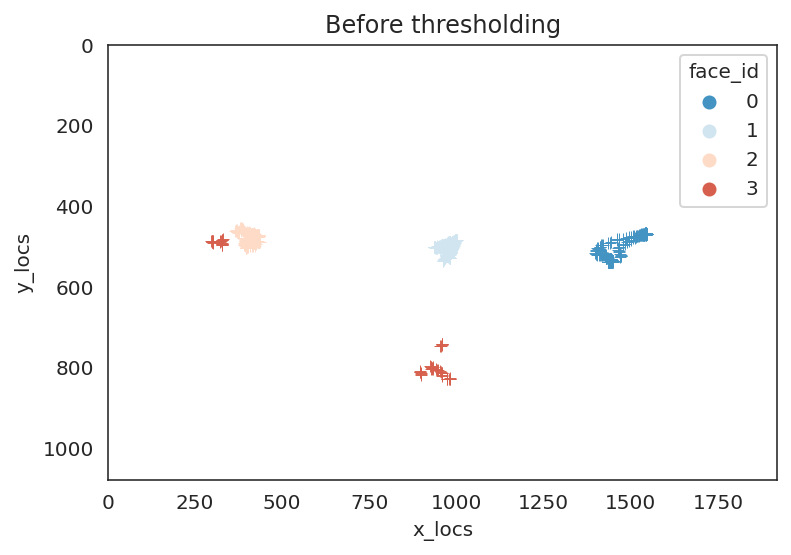

In [ ]:
import re
x_regex_pat = re.compile(r'^x_[0-9]+$')
y_regex_pat = re.compile(r'^y_[0-9]+$')
x_locs = df.columns[df.columns.str.contains(x_regex_pat)]
y_locs = df.columns[df.columns.str.contains(y_regex_pat)]
no_unique_faces = len(df.face_id.unique())
palette = sns.color_palette("RdBu_r", no_unique_faces)

avg_face_df = pd.DataFrame({'x_locs':df[x_locs].mean(axis=1), 'y_locs':df[y_locs].mean(axis=1), 'face_id': df.face_id})
ax = sns.scatterplot(x='x_locs', y='y_locs', hue = 'face_id', data=avg_face_df, marker="+", palette=palette)
ax.set(xlim=[0, 1920], ylim=[1080,0], title="Before thresholding");

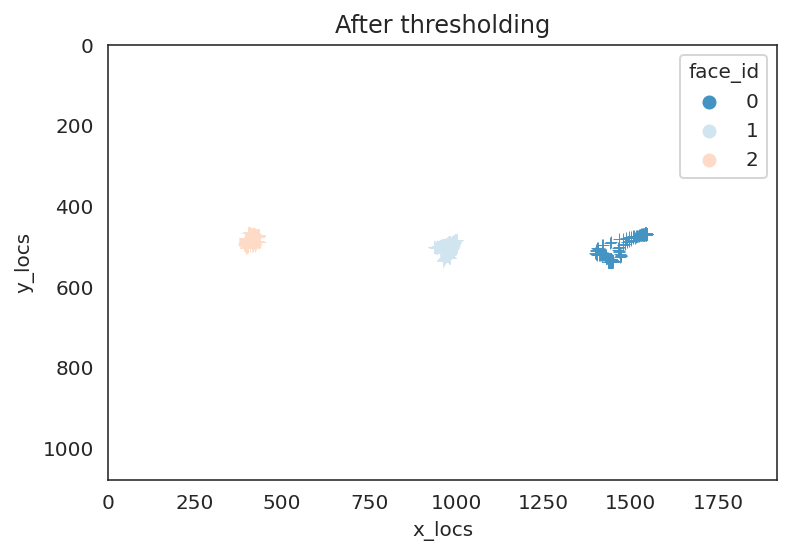

In [ ]:
avg_face_df_conf = avg_face_df[df.confidence>=.80]
no_unique_faces = len(avg_face_df_conf.face_id.unique())
ax = sns.scatterplot(x='x_locs', y='y_locs', hue = 'face_id', data=avg_face_df_conf, marker="+", palette=palette[:no_unique_faces])
ax.set(xlim=[0, 1920], ylim=[1080,0], title="After thresholding");

Let's clean our data with a threshold of 80% confidence and plot the AU trajectories for all AUs.


List of AU columns: Index(['AU01_r', 'AU02_r', 'AU04_r', 'AU05_r', 'AU06_r', 'AU07_r', 'AU09_r',
       'AU10_r', 'AU12_r', 'AU14_r', 'AU15_r', 'AU17_r', 'AU20_r', 'AU23_r',
       'AU25_r', 'AU26_r', 'AU45_r'],
      dtype='object')


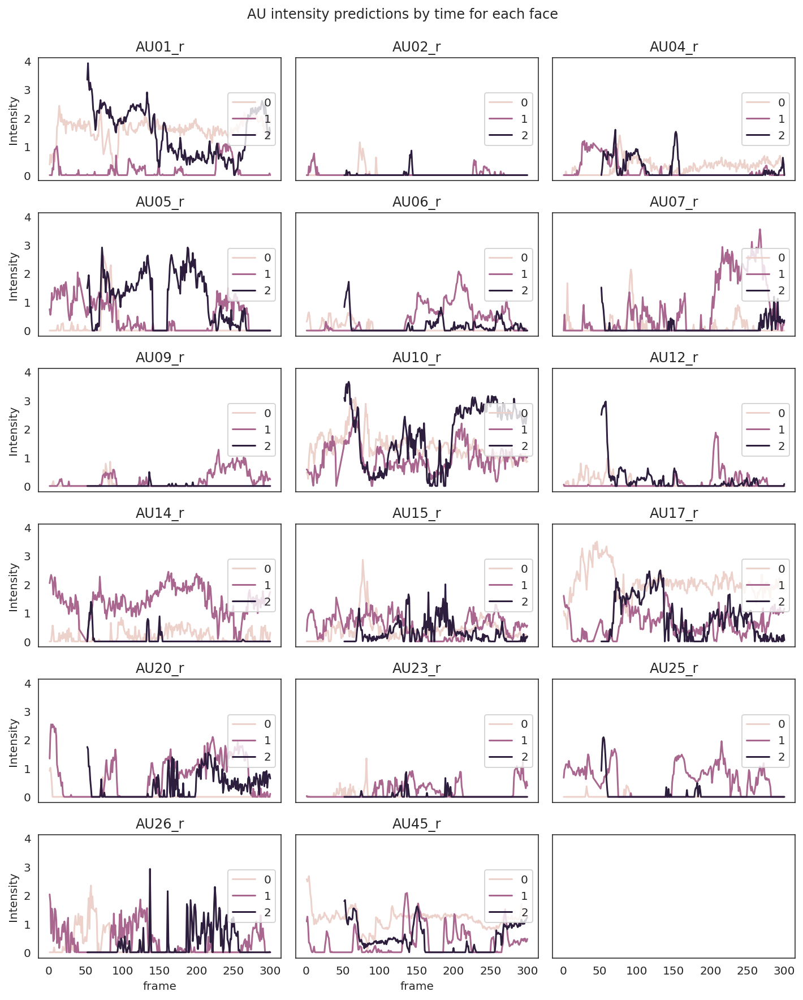

In [ ]:
# Threshold data by 80%
df_clean = df[df.confidence>=.80]
# Plot all Action Unit time series. 
au_regex_pat = re.compile(r'^AU[0-9]+_r$')
au_columns = df.columns[df.columns.str.contains(au_regex_pat)]
print("List of AU columns:", au_columns)
f,axes = plt.subplots(6, 3, figsize=(10,12), sharex=True, sharey=True)
axes = axes.flatten()
for au_ix, au_col in enumerate(au_columns):
    sns.lineplot(x='frame', y=au_col, hue='face_id', data=df_clean, ax=axes[au_ix])
    axes[au_ix].set(title=au_col, ylabel='Intensity')
    axes[au_ix].legend(loc=5)
plt.suptitle("AU intensity predictions by time for each face", y=1.02)
plt.tight_layout()

We could also compare how synchronized each individuals are to one another during the interaction by using a simple Pearson correlation.

In [ ]:
# Let's compare how much AU12 (smiling) activity occurs at similar times across people.
df_clean.pivot(index='frame', columns='face_id', values='AU12_r').corr()

face_id,0,1,2
face_id,,,
0,1.000000,-0.145006,0.451838
1,-0.145006,1.000000,-0.124261
2,0.451838,-0.124261,1.000000


# Lastly, here is just a few lines of code to get you started on working with gaze directions. 

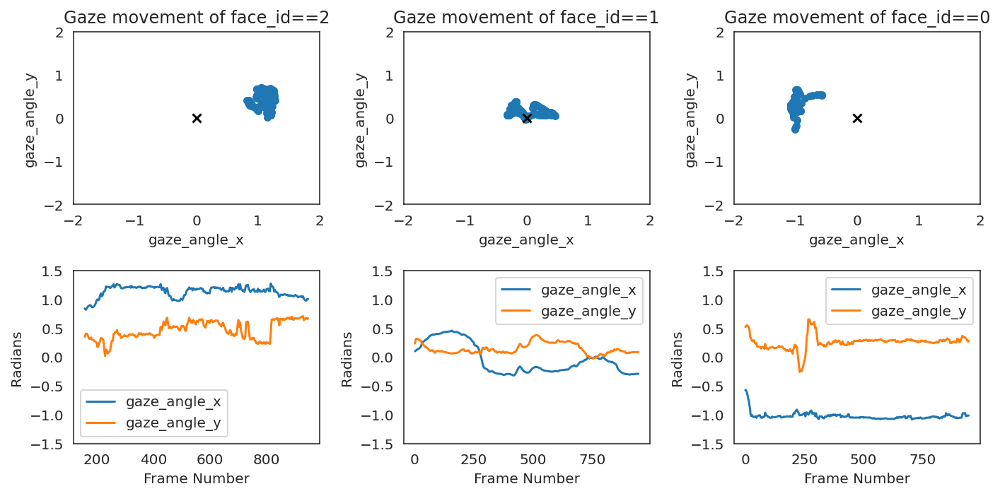

In [ ]:
f,axes = plt.subplots(2,len(df_clean.face_id.unique()), figsize=(10,5))
for faces_ix, face_id in enumerate(df_clean.face_id.unique()[::-1]):
  df_clean.query(f'face_id=={face_id}').plot.scatter(x='gaze_angle_x', y='gaze_angle_y', ax=axes[0][faces_ix])
  axes[0][faces_ix].scatter(0,0, marker='x', color = 'k') # draw origin.
  axes[0][faces_ix].set(xlim=[-2,2], ylim=[-2,2], title=f'Gaze movement of face_id=={face_id}')
  df_clean.query(f'face_id=={face_id}')[['gaze_angle_x', 'gaze_angle_y']].plot(ax=axes[1][faces_ix])
  axes[1][faces_ix].set(ylim=[-1.5,1.5], xlabel='Frame Number', ylabel="Radians")
plt.tight_layout()
plt.show()

In [ ]:
# from google.colab import drive
# drive.mount('/content/drive')

# !zip -r "drive/MyDrive/AIHealthcare/Openface.zip" "/content/OpenF/"

Mounted at /content/drive


# Deploy

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
ls 'drive/MyDrive/AIHealthcare/Openface.zip'

drive/MyDrive/AIHealthcare/Openface.zip


In [ ]:
!unzip "drive/MyDrive/AIHealthcare/Openface.zip"

Streaming output truncated to the last 5000 lines.
  inflating: content/OpenF/OpenFace/dlib-19.13/dlib/misc_api.h  
  inflating: content/OpenF/OpenFace/dlib-19.13/dlib/sockets.h  
  inflating: content/OpenF/OpenFace/dlib-19.13/dlib/dir_nav.h  
  inflating: content/OpenF/OpenFace/dlib-19.13/dlib/pipe.h  
  inflating: content/OpenF/OpenFace/dlib-19.13/dlib/std_allocator.h  
  inflating: content/OpenF/OpenFace/dlib-19.13/dlib/dnn.h  
   creating: content/OpenF/OpenFace/dlib-19.13/dlib/statistics/
  inflating: content/OpenF/OpenFace/dlib-19.13/dlib/statistics/average_precision_abstract.h  
  inflating: content/OpenF/OpenFace/dlib-19.13/dlib/statistics/cca.h  
  inflating: content/OpenF/OpenFace/dlib-19.13/dlib/statistics/sammon_abstract.h  
  inflating: content/OpenF/OpenFace/dlib-19.13/dlib/statistics/dpca.h  
  inflating: content/OpenF/OpenFace/dlib-19.13/dlib/statistics/running_gradient_abstract.h  
  inflating: content/OpenF/OpenFace/dlib-19.13/dlib/statistics/random_subset_selector.h 

In [ ]:
import os
from os.path import exists, join, basename, splitext

!apt-get --purge remove cuda nvidia* libnvidia-*
!dpkg -l | grep cuda- | awk '{print $2}' | xargs -n1 dpkg --purge
!apt-get remove cuda-*
!apt autoremove
!apt-get update

!dpkg -i cuda-repo-ubuntu1804_10.0.130-1_amd64.deb
!sudo apt-key adv --fetch-keys https://developer.download.nvidia.com/compute/cuda/repos/ubuntu1804/x86_64/7fa2af80.pub
!apt-get update
!apt-get install cuda-10-0
!apt install ./nvidia-machine-learning-repo-ubuntu1804_1.0.0-1_amd64.deb
!apt-get update
!tar xfz cmake-3.13.0-Linux-x86_64.tar.gz --strip-components=1 -C /usr/local

!sudo apt-get update
!sudo apt-get install build-essential 
!sudo apt-get install g++-8

!pip install -q youtube-dl
# !cd OpenFace && sudo bash ./install.sh
# !cd OpenFace

Reading package lists... Done
Building dependency tree       
Reading state information... Done
Note, selecting 'libnvidia-encode-418-server' for glob 'libnvidia-*'
Note, selecting 'libnvidia-compute-450-server' for glob 'libnvidia-*'
Note, selecting 'libnvidia-gl-460-server' for glob 'libnvidia-*'
Note, selecting 'libnvidia-encode' for glob 'libnvidia-*'
Note, selecting 'libnvidia-fbc1-450-server' for glob 'libnvidia-*'
Note, selecting 'libnvidia-compute-440-server' for glob 'libnvidia-*'
Note, selecting 'libnvidia-gl-450-server' for glob 'libnvidia-*'
Note, selecting 'libnvidia-compute-390' for glob 'libnvidia-*'
Note, selecting 'libnvidia-ifr1-418-server' for glob 'libnvidia-*'
Note, selecting 'libnvidia-fbc1-440-server' for glob 'libnvidia-*'
Note, selecting 'libnvidia-compute-410' for glob 'libnvidia-*'
Note, selecting 'libnvidia-compute-415' for glob 'libnvidia-*'
Note, selecting 'libnvidia-compute-418' for glob 'libnvidia-*'
Note, selecting 'libnvidia-compute-430' for glob 'libn

In [ ]:
!cd OpenFace && sudo bash ./install.sh

Streaming output truncated to the last 5000 lines.
  inflating: opencv-4.1.0/samples/cpp/create_mask.cpp  
  inflating: opencv-4.1.0/samples/cpp/dbt_face_detection.cpp  
  inflating: opencv-4.1.0/samples/cpp/delaunay2.cpp  
  inflating: opencv-4.1.0/samples/cpp/demhist.cpp  
  inflating: opencv-4.1.0/samples/cpp/detect_blob.cpp  
  inflating: opencv-4.1.0/samples/cpp/detect_mser.cpp  
  inflating: opencv-4.1.0/samples/cpp/dft.cpp  
  inflating: opencv-4.1.0/samples/cpp/dis_opticalflow.cpp  
  inflating: opencv-4.1.0/samples/cpp/distrans.cpp  
  inflating: opencv-4.1.0/samples/cpp/drawing.cpp  
  inflating: opencv-4.1.0/samples/cpp/edge.cpp  
  inflating: opencv-4.1.0/samples/cpp/ela.cpp  
  inflating: opencv-4.1.0/samples/cpp/em.cpp  
   creating: opencv-4.1.0/samples/cpp/example_cmake/
  inflating: opencv-4.1.0/samples/cpp/example_cmake/CMakeLists.txt  
  inflating: opencv-4.1.0/samples/cpp/example_cmake/Makefile  
  inflating: opencv-4.1.0/samples/cpp/example_cmake/example.cpp  
  in

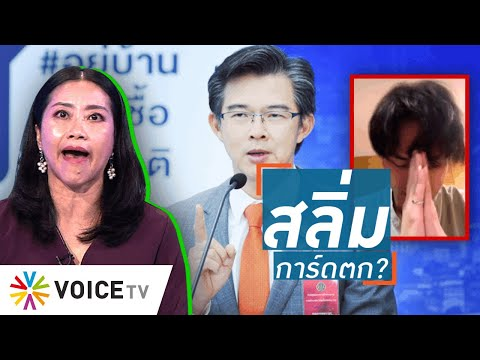

In [ ]:
from IPython.display import YouTubeVideo

# Change the Youtube_ID with the link to your group's video.
YOUTUBE_ID = 'PIDzGDY-MpY'

YouTubeVideo(YOUTUBE_ID)

In [ ]:
!rm -rf youtube.mp4
# download the youtube with the given ID
!youtube-dl -f 'bestvideo[ext=mp4]' --output "youtube.%(ext)s" https://www.youtube.com/watch?v=$YOUTUBE_ID
# cut the first 5 seconds
!ffmpeg -y -loglevel info -i youtube.mp4 -t 30 video.mp4
# clear any previous outputs.
!rm -rf processed
# detect poses on the these 10 seconds.
!./OpenFace/build/bin/FaceLandmarkVidMulti -f video.mp4 -out_dir processed
# convert the result into MP4
!ffmpeg -y -loglevel info -i processed/video.avi output.mp4

[youtube] PIDzGDY-MpY: Downloading webpage
[download] Destination: youtube.mp4
[download] 100% of 195.87MiB in 00:20
ffmpeg version 3.4.8-0ubuntu0.2 Copyright (c) 2000-2020 the FFmpeg developers
  built with gcc 7 (Ubuntu 7.5.0-3ubuntu1~18.04)
  configuration: --prefix=/usr --extra-version=0ubuntu0.2 --toolchain=hardened --libdir=/usr/lib/x86_64-linux-gnu --incdir=/usr/include/x86_64-linux-gnu --enable-gpl --disable-stripping --enable-avresample --enable-avisynth --enable-gnutls --enable-ladspa --enable-libass --enable-libbluray --enable-libbs2b --enable-libcaca --enable-libcdio --enable-libflite --enable-libfontconfig --enable-libfreetype --enable-libfribidi --enable-libgme --enable-libgsm --enable-libmp3lame --enable-libmysofa --enable-libopenjpeg --enable-libopenmpt --enable-libopus --enable-libpulse --enable-librubberband --enable-librsvg --enable-libshine --enable-libsnappy --enable-libsoxr --enable-libspeex --enable-libssh --enable-libtheora --enable-libtwolame --enable-libvorbis

In [ ]:
def show_local_mp4_video(file_name, width=640, height=480):
  import io
  import base64
  from IPython.display import HTML
  video_encoded = base64.b64encode(io.open(file_name, 'rb').read())
  return HTML(data='''<video width="{0}" height="{1}" alt="test" controls>
                        <source src="data:video/mp4;base64,{2}" type="video/mp4" />
                      </video>'''.format(width, height, video_encoded.decode('ascii')))

show_local_mp4_video('output.mp4', width=960, height=720)

In [ ]:
%matplotlib inline
%config InlineBackend.figure_format = 'retina'
import pandas as pd, seaborn as sns
sns.set_style('white')
import matplotlib.pyplot as plt 

# Load data
df = pd.read_csv('processed/video.csv')
# Remove empty spaces in column names.
df.columns = [col.replace(" ", "") for col in df.columns]
# Print few values of data.
print(f"Max number of frames {df.frame.max()}", f"\nTotal shape of dataframe {df.shape}")
df.head()

Max number of frames 750 
Total shape of dataframe (743, 714)


,frame,face_id,timestamp,confidence,success,gaze_0_x,gaze_0_y,gaze_0_z,gaze_1_x,gaze_1_y,gaze_1_z,gaze_angle_x,gaze_angle_y,eye_lmk_x_0,eye_lmk_x_1,eye_lmk_x_2,eye_lmk_x_3,eye_lmk_x_4,eye_lmk_x_5,eye_lmk_x_6,eye_lmk_x_7,eye_lmk_x_8,eye_lmk_x_9,eye_lmk_x_10,eye_lmk_x_11,eye_lmk_x_12,eye_lmk_x_13,eye_lmk_x_14,eye_lmk_x_15,eye_lmk_x_16,eye_lmk_x_17,eye_lmk_x_18,eye_lmk_x_19,eye_lmk_x_20,eye_lmk_x_21,eye_lmk_x_22,eye_lmk_x_23,eye_lmk_x_24,eye_lmk_x_25,eye_lmk_x_26,...,p_29,p_30,p_31,p_32,p_33,AU01_r,AU02_r,AU04_r,AU05_r,AU06_r,AU07_r,AU09_r,AU10_r,AU12_r,AU14_r,AU15_r,AU17_r,AU20_r,AU23_r,AU25_r,AU26_r,AU45_r,AU01_c,AU02_c,AU04_c,AU05_c,AU06_c,AU07_c,AU09_c,AU10_c,AU12_c,AU14_c,AU15_c,AU17_c,AU20_c,AU23_c,AU25_c,AU26_c,AU28_c,AU45_c
0,1,0,0.00,0.98,1,-0.080952,0.282465,-0.955856,-0.300165,0.234174,-0.924696,-0.200,0.268,1056.0,1059.5,1067.2,1074.6,1077.4,1074.5,1066.2,1058.7,1046.2,1050.3,1056.5,1065.0,1073.7,1080.0,1084.6,1078.5,1070.8,1062.9,1055.8,1050.1,1062.9,1066.7,1070.6,1072.5,1071.1,1067.3,1063.3,...,0.362,-0.274,0.228,-0.007,0.020,2.62,3.26,0.0,2.26,0.0,0.11,0.0,0.0,0.00,0.24,0.82,0.00,0.78,0.04,0.17,0.82,0.0,1.0,1.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,1.0,1.0,1.0,0.0,0.0
1,2,0,0.04,0.98,1,-0.061151,0.293138,-0.954113,-0.250306,0.226926,-0.941197,-0.163,0.268,1050.3,1053.6,1061.3,1068.8,1071.7,1069.1,1060.8,1053.3,1040.8,1044.4,1050.2,1058.4,1067.2,1073.8,1078.7,1072.5,1064.7,1056.9,1049.8,1044.4,1057.7,1061.3,1065.0,1066.6,1065.2,1061.5,1057.9,...,0.450,-0.071,0.174,0.118,0.034,2.93,3.29,0.0,1.94,0.0,0.60,0.0,0.0,0.00,0.29,0.87,0.31,0.62,0.47,0.00,1.08,0.0,1.0,1.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,1.0,0.0,1.0,0.0,0.0
2,3,0,0.08,0.98,1,-0.027673,0.294152,-0.955358,-0.264465,0.243136,-0.933243,-0.153,0.277,1045.3,1048.4,1055.9,1063.4,1066.6,1064.2,1056.0,1048.5,1034.9,1038.6,1044.6,1053.0,1061.8,1068.3,1073.0,1067.1,1059.3,1051.5,1044.4,1038.8,1052.7,1056.2,1059.8,1061.2,1059.7,1056.2,1052.7,...,0.433,-0.110,0.322,0.140,0.016,2.74,3.36,0.0,1.56,0.0,0.51,0.0,0.0,0.00,0.00,0.76,0.58,0.35,0.47,0.00,0.83,0.0,1.0,1.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,1.0,0.0,1.0,0.0,0.0
3,4,0,0.12,0.98,1,-0.000736,0.297844,-0.954614,-0.217098,0.231581,-0.948282,-0.114,0.271,1040.6,1043.5,1050.9,1058.6,1062.0,1059.8,1051.7,1044.1,1029.3,1033.3,1039.6,1048.3,1057.2,1063.5,1068.2,1062.5,1054.9,1047.0,1039.8,1033.7,1048.1,1051.6,1055.1,1056.4,1054.8,1051.3,1047.9,...,0.398,-0.141,0.385,0.128,-0.050,2.80,3.33,0.0,1.43,0.0,0.33,0.0,0.0,0.03,0.01,0.87,0.78,0.20,0.56,0.00,0.59,0.0,1.0,1.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,1.0,0.0,1.0,0.0,0.0
4,5,0,0.16,0.98,1,0.014673,0.297535,-0.954598,-0.202681,0.258317,-0.944559,-0.099,0.285,1036.1,1038.7,1046.1,1053.9,1057.6,1055.5,1047.5,1039.7,1024.6,1028.6,1034.9,1043.3,1052.3,1058.8,1063.7,1058.0,1050.5,1042.7,1035.3,1029.2,1043.7,1047.3,1050.7,1051.9,1050.3,1046.7,1043.2,...,0.365,-0.011,0.224,0.109,-0.071,2.64,3.41,0.0,2.25,0.0,1.34,0.0,0.0,0.32,0.00,0.58,0.00,0.00,0.00,0.59,1.07,0.0,1.0,1.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,1.0,1.0,0.0,0.0


List of AU columns: Index(['AU01_r', 'AU02_r', 'AU04_r', 'AU05_r', 'AU06_r', 'AU07_r', 'AU09_r',
       'AU10_r', 'AU12_r', 'AU14_r', 'AU15_r', 'AU17_r', 'AU20_r', 'AU23_r',
       'AU25_r', 'AU26_r', 'AU45_r'],
      dtype='object')


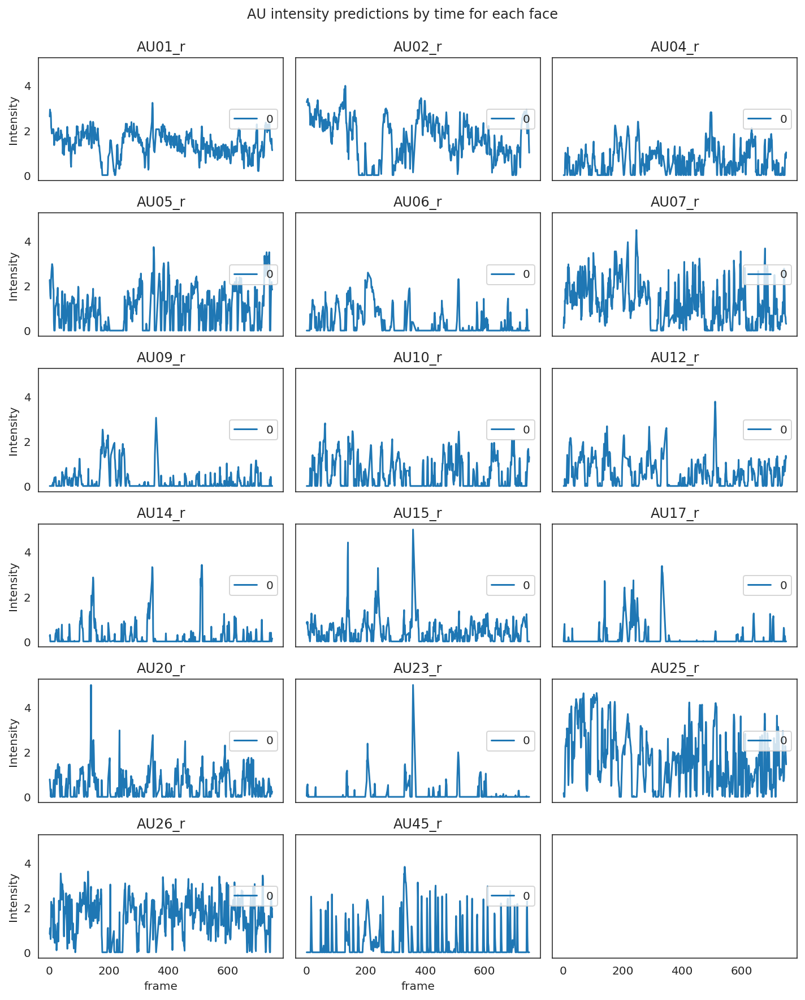

In [ ]:
import re
# Threshold data by 80%
df_clean = df[df.confidence>=.80]
# Plot all Action Unit time series. 
au_regex_pat = re.compile(r'^AU[0-9]+_r$')
au_columns = df.columns[df.columns.str.contains(au_regex_pat)]
print("List of AU columns:", au_columns)
f,axes = plt.subplots(6, 3, figsize=(10,12), sharex=True, sharey=True)
axes = axes.flatten()
for au_ix, au_col in enumerate(au_columns):
    sns.lineplot(x='frame', y=au_col, hue='face_id', data=df_clean, ax=axes[au_ix])
    axes[au_ix].set(title=au_col, ylabel='Intensity')
    axes[au_ix].legend(loc=5)
plt.suptitle("AU intensity predictions by time for each face", y=1.02)
plt.tight_layout()